In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import metrics
from scipy.stats import itemfreq
%matplotlib inline
import warnings
from sklearn.model_selection import ShuffleSplit,learning_curve,GridSearchCV,RandomizedSearchCV
import re
from datetime import datetime
import math

In [2]:
listing= pd.read_csv('listings.csv')

C:\ProgramData\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3057: DtypeWarning: Columns (61,62,94) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [3]:
listing

,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,...,instant_bookable,is_business_travel_ready,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,2818,https://www.airbnb.com/rooms/2818,20190914033014,2019-09-14,Quiet Garden View Room & Super Fast WiFi,Quiet Garden View Room & Super Fast WiFi,I'm renting a bedroom (room overlooking the ga...,Quiet Garden View Room & Super Fast WiFi I'm r...,none,"Indische Buurt (""Indies Neighborhood"") is a ne...",...,t,f,strict_14_with_grace_period,f,f,1,0,1,0,2.11
1,20168,https://www.airbnb.com/rooms/20168,20190914033014,2019-09-14,Studio with private bathroom in the centre 1,"Cozy studio on your own private floor, 100% in...",For those who like all facets of city life. In...,"Cozy studio on your own private floor, 100% in...",none,Located just in between famous central canals....,...,f,f,strict_14_with_grace_period,f,f,2,0,2,0,2.48
2,25428,https://www.airbnb.com/rooms/25428,20190914033014,2019-09-14,Lovely apt in City Centre (w.lift) near Jordaan,NaN,"This nicely furnished, newly renovated apt is...","This nicely furnished, newly renovated apt is...",none,NaN,...,f,f,strict_14_with_grace_period,f,f,2,2,0,0,0.15
3,27886,https://www.airbnb.com/rooms/27886,20190914033014,2019-09-14,"Romantic, stylish B&B houseboat in canal district",Stylish and romantic houseboat on fantastic hi...,For a romantic couple: A beautifully restored ...,Stylish and romantic houseboat on fantastic hi...,none,"Central, quiet, safe, clean and beautiful.",...,t,f,strict_14_with_grace_period,f,f,1,0,1,0,2.14
4,28871,https://www.airbnb.com/rooms/28871,20190914033014,2019-09-14,Comfortable double room,NaN,In a monumental house right in the center of A...,In a monumental house right in the center of A...,none,NaN,...,f,f,moderate,f,f,3,0,3,0,2.67
5,29051,https://www.airbnb.com/rooms/29051,20190914033014,2019-09-14,Comfortable single room,because of the city imposing a 4 paying guest ...,In a monumental house right in the center of A...,because of the city imposing a 4 paying guest ...,none,the street is quite lively especially on weeke...,...,f,f,moderate,f,f,3,0,3,0,4.31
6,31080,https://www.airbnb.com/rooms/31080,20190914033014,2019-09-14,2-story apartment + rooftop terrace,NaN,My apartment is light and cosy. The three bed...,My apartment is light and cosy. The three bed...,none,NaN,...,f,f,moderate,f,f,1,1,0,0,0.32
7,42970,https://www.airbnb.com/rooms/42970,20190914033014,2019-09-14,Comfortable room@PERFECT location + 2 bikes,A home away from home Great location Including...,"What I offer: great location, comfortable bed,...",A home away from home Great location Including...,none,My home is in the best neighborhood. Everythin...,...,t,f,strict_14_with_grace_period,f,t,2,0,0,0,4.19
8,43109,https://www.airbnb.com/rooms/43109,20190914033014,2019-09-14,Oasis in the middle of Amsterdam,NaN,Welcome to my beautiful. light and spacious (1...,Welcome to my beautiful. light and spacious (1...,none,You almost can't be more central then this.,...,f,f,moderate,f,f,1,1,0,0,23.99
9,43980,https://www.airbnb.com/rooms/43980,20190914033014,2019-09-14,View into park / museum district (long/short s...,RELOCATE RENTAL / ASK FOR LONG TERM RELOCATION...,"Exclusive park view area, 10 min. walk to Leid...",RELOCATE RENTAL / ASK FOR LONG TERM RELOCATION...,none,Residential. Young crowd and young families li...,...,f,f,strict_14_with_grace_period,t,t,2,2,0,0,0.56


In [4]:
listing.shape

(20244, 106)

In [5]:
for i in listing.columns: print(i)

id
listing_url
scrape_id
last_scraped
name
summary
space
description
experiences_offered
neighborhood_overview
notes
transit
access
interaction
house_rules
thumbnail_url
medium_url
picture_url
xl_picture_url
host_id
host_url
host_name
host_since
host_location
host_about
host_response_time
host_response_rate
host_acceptance_rate
host_is_superhost
host_thumbnail_url
host_picture_url
host_neighbourhood
host_listings_count
host_total_listings_count
host_verifications
host_has_profile_pic
host_identity_verified
street
neighbourhood
neighbourhood_cleansed
neighbourhood_group_cleansed
city
state
zipcode
market
smart_location
country_code
country
latitude
longitude
is_location_exact
property_type
room_type
accommodates
bathrooms
bedrooms
beds
bed_type
amenities
square_feet
price
weekly_price
monthly_price
security_deposit
cleaning_fee
guests_included
extra_people
minimum_nights
maximum_nights
minimum_minimum_nights
maximum_minimum_nights
minimum_maximum_nights
maximum_maximum_nights
minimum_ni

In [6]:
listing['cancellation_policy'].value_counts()

strict_14_with_grace_period    7905
moderate                       7281
flexible                       4915
super_strict_60                 116
super_strict_30                  27
Name: cancellation_policy, dtype: int64

In [7]:
listing_1= listing[['id',
                   'host_id', 
                   'host_name',
                   'host_is_superhost',
                   'host_identity_verified',
                   'latitude',
                   'longitude',
                   'neighbourhood_cleansed',
                   'price',
                   'property_type',
                   'room_type',
                   'accommodates',
                   'bedrooms',
                   'bathrooms',
                   'square_feet',
                   'security_deposit',
                   'cleaning_fee',
                   'guests_included',
                   'extra_people',
                   'minimum_nights',
                   'maximum_nights',
                   'review_scores_rating',
                   'availability_365',
                   'number_of_reviews',
                   'instant_bookable',
                   'cancellation_policy',
                   'require_guest_profile_picture',
                   'require_guest_phone_verification',
                   'neighbourhood_group_cleansed']]

In [8]:
listing_1.to_csv('listing_for_modeling.csv')

In [9]:
listing_1.shape

(20244, 29)

## Data Cleansing: 
### 1. Checking for Nulls 

In [10]:
listing_1.isnull().sum()

id                                      0
host_id                                 0
host_name                               5
host_is_superhost                       5
host_identity_verified                  5
latitude                                0
longitude                               0
neighbourhood_cleansed                  0
price                                   0
property_type                           0
room_type                               0
accommodates                            0
bedrooms                               14
bathrooms                               7
square_feet                         19873
security_deposit                     6053
cleaning_fee                         3611
guests_included                         0
extra_people                            0
minimum_nights                          0
maximum_nights                          0
review_scores_rating                 2565
availability_365                        0
number_of_reviews                 

### 2. Deleting Columns with more than 60% Null values 

In [11]:
x = listing_1.isna().mean().round(4) * 100
d = pd.DataFrame(x[x > 60])
d.head()
l = list(d.index)
l

['square_feet', 'neighbourhood_group_cleansed']

In [12]:
listing_1.drop(columns=['square_feet', 'neighbourhood_group_cleansed'], inplace=True)

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\frame.py:3940: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  errors=errors)


### 3. Data Integrity: Consistency in datatypes for all columns 
#### a. Converting price which is in the format $xxx.xx into float 

In [13]:
listing_1['price']=listing_1['price'].apply(lambda x: round(float(str(x).strip('$').replace(',',''))))

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


#### b. Converting extra people which is in the format $xxx.xx into float 

In [14]:
listing_1['extra_people'] = listing_1['extra_people'].apply(lambda x: float(str(x).strip('$').replace(',','')))

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [15]:
listing_1['price']

0          59
1          80
2         125
3         155
4          75
5          55
6         219
7         159
8         210
9         100
10        240
11        150
12        140
13        350
14        220
15        250
16        120
17        125
18        115
19         90
20         80
21         87
22         75
23         60
24         86
25        222
26        250
27        159
28         60
29        149
         ... 
20214     129
20215      60
20216     150
20217     150
20218     185
20219    1208
20220     110
20221     109
20222     175
20223     223
20224    1000
20225     150
20226     200
20227     199
20228      72
20229     275
20230      80
20231      70
20232     150
20233      70
20234     110
20235      70
20236     160
20237     120
20238     110
20239     350
20240     200
20241      50
20242     124
20243     150
Name: price, Length: 20244, dtype: int64

In [16]:
listing_1['extra_people']

0        20.0
1         0.0
2        10.0
3         0.0
4         0.0
5         0.0
6        30.0
7         0.0
8        60.0
9         0.0
10        0.0
11       50.0
12       25.0
13       50.0
14       50.0
15       50.0
16       30.0
17       50.0
18        0.0
19       25.0
20        0.0
21        0.0
22        0.0
23       25.0
24       20.0
25        0.0
26       50.0
27       35.0
28        0.0
29       20.0
         ... 
20214    35.0
20215     0.0
20216     0.0
20217    15.0
20218     0.0
20219     0.0
20220     0.0
20221     0.0
20222     0.0
20223     0.0
20224     0.0
20225     0.0
20226    25.0
20227    17.0
20228     0.0
20229     0.0
20230     0.0
20231     0.0
20232     0.0
20233     0.0
20234    10.0
20235     0.0
20236     0.0
20237     0.0
20238     0.0
20239     0.0
20240     0.0
20241     0.0
20242    50.0
20243     0.0
Name: extra_people, Length: 20244, dtype: float64

#### c. Converting security deposit which is in the format $xxx.xx into float 

In [17]:
listing_1['security_deposit']=listing_1['security_deposit'].apply(lambda x: float(str(x).strip('$').replace(',','')))

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [18]:
listing_1['security_deposit'].isna().sum()

6053

#### Imputing Nulls for security deposit with mean value

In [19]:
listing_1['security_deposit']=listing_1['security_deposit'].fillna(listing_1['security_deposit'].mean())

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [20]:
listing_1['security_deposit'].isna().sum()

0

#### d. Converting cleaning fee which is in the format $xxx.xx into float 

In [21]:
listing_1['cleaning_fee'] = listing_1['cleaning_fee'].apply(lambda x: float(str(x).strip('$').replace(',','')))

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [22]:
listing_1['cleaning_fee'].isna().sum()

3611

#### Imputing Nulls for security deposit with mean value

In [23]:
listing_1['cleaning_fee']=listing_1['cleaning_fee'].fillna(listing_1['cleaning_fee'].mean())

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [24]:
listing_1['cleaning_fee'].isna().sum()

0

### Null check after Data Integrity check

In [25]:
listing_1.isna().sum()

id                                     0
host_id                                0
host_name                              5
host_is_superhost                      5
host_identity_verified                 5
latitude                               0
longitude                              0
neighbourhood_cleansed                 0
price                                  0
property_type                          0
room_type                              0
accommodates                           0
bedrooms                              14
bathrooms                              7
security_deposit                       0
cleaning_fee                           0
guests_included                        0
extra_people                           0
minimum_nights                         0
maximum_nights                         0
review_scores_rating                2565
availability_365                       0
number_of_reviews                      0
instant_bookable                       0
cancellation_pol

#### Imputing mean for nulls in review scores rating

In [26]:
listing_1['review_scores_rating']=listing_1['review_scores_rating'].fillna(listing_1['review_scores_rating'].mean())

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [27]:
listing_1.isna().sum()

id                                   0
host_id                              0
host_name                            5
host_is_superhost                    5
host_identity_verified               5
latitude                             0
longitude                            0
neighbourhood_cleansed               0
price                                0
property_type                        0
room_type                            0
accommodates                         0
bedrooms                            14
bathrooms                            7
security_deposit                     0
cleaning_fee                         0
guests_included                      0
extra_people                         0
minimum_nights                       0
maximum_nights                       0
review_scores_rating                 0
availability_365                     0
number_of_reviews                    0
instant_bookable                     0
cancellation_policy                  0
require_guest_profile_pic

In [28]:
listing_1.dropna(axis=0,inplace=True)

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [29]:
listing_1.isna().sum()

id                                  0
host_id                             0
host_name                           0
host_is_superhost                   0
host_identity_verified              0
latitude                            0
longitude                           0
neighbourhood_cleansed              0
price                               0
property_type                       0
room_type                           0
accommodates                        0
bedrooms                            0
bathrooms                           0
security_deposit                    0
cleaning_fee                        0
guests_included                     0
extra_people                        0
minimum_nights                      0
maximum_nights                      0
review_scores_rating                0
availability_365                    0
number_of_reviews                   0
instant_bookable                    0
cancellation_policy                 0
require_guest_profile_picture       0
require_gues

In [30]:
listing_1

,id,host_id,host_name,host_is_superhost,host_identity_verified,latitude,longitude,neighbourhood_cleansed,price,property_type,...,extra_people,minimum_nights,maximum_nights,review_scores_rating,availability_365,number_of_reviews,instant_bookable,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification
0,2818,3159,Daniel,t,f,52.36575,4.94142,Oostelijk Havengebied - Indische Buurt,59,Apartment,...,20.0,3,15,98.000000,70,269,t,strict_14_with_grace_period,f,f
1,20168,59484,Alexander,f,f,52.36509,4.89354,Centrum-Oost,80,Townhouse,...,0.0,1,1000,88.000000,167,288,f,strict_14_with_grace_period,f,f
2,25428,56142,Joan,f,f,52.37297,4.88339,Centrum-West,125,Apartment,...,10.0,14,60,100.000000,58,3,f,strict_14_with_grace_period,f,f
3,27886,97647,Flip,t,t,52.38673,4.89208,Centrum-West,155,Houseboat,...,0.0,2,730,99.000000,264,200,t,strict_14_with_grace_period,f,f
4,28871,124245,Edwin,t,t,52.36719,4.89092,Centrum-West,75,Apartment,...,0.0,2,1825,97.000000,123,295,f,moderate,f,f
5,29051,124245,Edwin,t,t,52.36773,4.89151,Centrum-West,55,Apartment,...,0.0,2,730,95.000000,155,446,f,moderate,f,f
6,31080,133488,Nienke,f,t,52.35132,4.84838,Zuid,219,Apartment,...,30.0,3,365,95.000000,0,32,f,moderate,f,f
7,42970,187580,Micha,t,f,52.36781,4.89001,Centrum-West,159,Bed and breakfast,...,0.0,3,1100,98.000000,47,460,t,strict_14_with_grace_period,f,t
8,43109,188098,Aukje,f,t,52.37537,4.88932,Centrum-West,210,Apartment,...,60.0,13,14,97.000000,0,690,f,moderate,f,f
9,43980,65041,Ym,t,f,52.35746,4.86124,Zuid,100,Apartment,...,0.0,30,365,80.000000,153,61,f,strict_14_with_grace_period,t,t


In [31]:
# Dropping columns ID , Host_id and host_name (not useful for regression)

In [32]:
listing_1.drop(['id','host_id','host_name'],axis=1,inplace=True)

**Data Distribution**

In [33]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

In [34]:
listing_1.columns

Index(['host_is_superhost', 'host_identity_verified', 'latitude', 'longitude',
       'neighbourhood_cleansed', 'price', 'property_type', 'room_type',
       'accommodates', 'bedrooms', 'bathrooms', 'security_deposit',
       'cleaning_fee', 'guests_included', 'extra_people', 'minimum_nights',
       'maximum_nights', 'review_scores_rating', 'availability_365',
       'number_of_reviews', 'instant_bookable', 'cancellation_policy',
       'require_guest_profile_picture', 'require_guest_phone_verification'],
      dtype='object')

In [38]:
col1=[ 'price', 'instant_bookable',
       'require_guest_profile_picture', 'require_guest_phone_verification',
       'accommodates', 'bedrooms', 'bathrooms', 'security_deposit',
       'cleaning_fee', 'guests_included', 'extra_people', 'minimum_nights',
       'maximum_nights', 'review_scores_rating', 'availability_365',
       'number_of_reviews','property_type', 'cancellation_policy',
       'neighbourhood_cleansed', 'room_type']

In [39]:

fig = make_subplots(rows=7, cols=4,subplot_titles=col1)

a=1
b=1
for i in col1:
    fig.append_trace(go.Histogram(x=listing_1[i],name=i,marker_color='#EB89B5'),a, b)
    if b==4:
        b=1
        a+=1
    else : b+=1
        
fig.update_layout(
    autosize=False,
    width=1200,
    height=1000,
)

fig.show()

In [35]:
# Based on above plot we found require_guest_profile, require_guest_phone verification can be removed
listing_1.drop(['require_guest_profile_picture','require_guest_phone_verification'],axis=1,inplace=True)

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\frame.py:3940: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



In [36]:
# Also there are columns with few records for a particular category that can be combined into same
listing_1['room_type'].value_counts()

Entire home/apt    15862
Private room        3843
Hotel room           460
Shared room           53
Name: room_type, dtype: int64

In [37]:
# Will combine hotel room and shared
listing_1['room_type'] = listing_1['room_type'].apply(lambda x: 'Hotel room' if x == 'Shared room' else x)

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



In [38]:
listing_1['cancellation_policy'].value_counts()

strict_14_with_grace_period    7902
moderate                       7274
flexible                       4899
super_strict_60                 116
super_strict_30                  27
Name: cancellation_policy, dtype: int64

In [39]:
# Will combine hotel room and shared
listing_1['cancellation_policy'] = listing_1['cancellation_policy'].apply(lambda x: 'super_strict_60' if x == 'super_strict_30' else x)
listing_1['cancellation_policy'] = listing_1['cancellation_policy'].apply(lambda x: 'strict_14_with_grace_period' if x == 'super_strict_60' else x)

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



In [40]:
listing_1['cancellation_policy'].value_counts()

strict_14_with_grace_period    8045
moderate                       7274
flexible                       4899
Name: cancellation_policy, dtype: int64

In [41]:
listing_1['room_type'].value_counts()

Entire home/apt    15862
Private room        3843
Hotel room           513
Name: room_type, dtype: int64

In [42]:
listing_1['property_type'].value_counts()

Apartment                 15446
House                      1621
Townhouse                   650
Bed and breakfast           508
Loft                        376
Boat                        361
Condominium                 359
Houseboat                   295
Guest suite                 142
Aparthotel                  115
Serviced apartment           74
Guesthouse                   48
Boutique hotel               39
Villa                        37
Other                        36
Hostel                       29
Hotel                        22
Cabin                        12
Tiny house                   12
Cottage                      11
Camper/RV                     5
Bungalow                      4
Casa particular (Cuba)        3
Barn                          3
Yurt                          2
Chalet                        2
Lighthouse                    1
Earth house                   1
Campsite                      1
Dome house                    1
Island                        1
Tent    

In [43]:
# property type is dominated by apartment so we can remove that column
listing_1.drop(['property_type'],axis=1,inplace=True)

**Outlier Detection**

In [44]:
fig = go.Figure()
for i in ['accommodates','guests_included','extra_people','cleaning_fee','bathrooms','bedrooms','security_deposit','number_of_reviews','review_scores_rating','maximum_nights','minimum_nights','availability_365','price']:
    fig.add_trace(go.Box(x=listing_1[i],name=i,marker_color='lightseagreen'))
fig.show()

**Removing outliers based on Price**

In [45]:
from scipy import stats
#listing_1=listing_1[(np.abs(stats.zscore(listing_1[['accommodates','guests_included','extra_people','cleaning_fee','bathrooms','bedrooms','security_deposit','number_of_reviews','review_scores_rating','maximum_nights','minimum_nights','availability_365','price']])) < 3).all(axis=1)]

In [46]:
from scipy import stats
listing_1=listing_1[(np.abs(stats.zscore(listing_1[['price']])) < 3).all(axis=1)]

In [47]:
listing_1.shape

(20065, 21)

In [48]:
fig = go.Figure()
for i in ['accommodates','guests_included','extra_people','cleaning_fee','bathrooms','bedrooms','security_deposit','number_of_reviews','review_scores_rating','maximum_nights','minimum_nights','availability_365','price']:
    fig.add_trace(go.Box(x=listing_1[i],name=i,marker_color='lightseagreen'))
fig.show()

**Correlation Matrix**

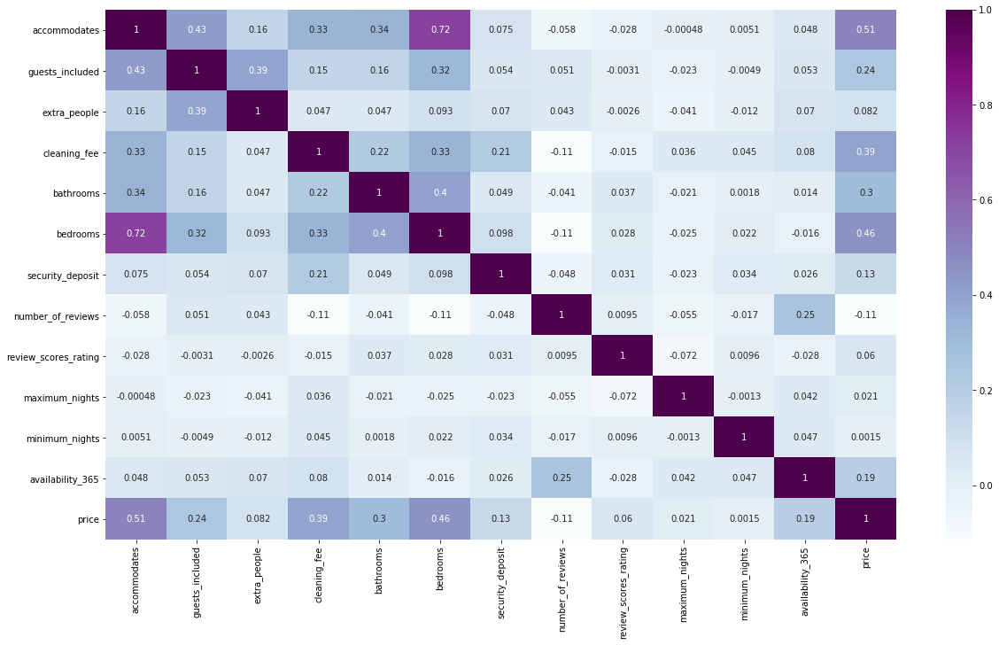

In [49]:
plt.figure(figsize=(20,11))
sns.heatmap(listing_1[['accommodates','guests_included','extra_people','cleaning_fee','bathrooms','bedrooms','security_deposit','number_of_reviews','review_scores_rating','maximum_nights','minimum_nights','availability_365','price']].corr(),annot=True,cmap="BuPu")
plt.show()

**Creating Dummies of Categorical variables for Linear regression**

In [50]:
listing_1.columns

Index(['host_is_superhost', 'host_identity_verified', 'latitude', 'longitude',
       'neighbourhood_cleansed', 'price', 'room_type', 'accommodates',
       'bedrooms', 'bathrooms', 'security_deposit', 'cleaning_fee',
       'guests_included', 'extra_people', 'minimum_nights', 'maximum_nights',
       'review_scores_rating', 'availability_365', 'number_of_reviews',
       'instant_bookable', 'cancellation_policy'],
      dtype='object')

In [51]:
dummies=pd.get_dummies(listing_1[['host_is_superhost','host_identity_verified','neighbourhood_cleansed','room_type','instant_bookable','cancellation_policy']])

In [52]:
dummies

,host_is_superhost_f,host_is_superhost_t,host_identity_verified_f,host_identity_verified_t,neighbourhood_cleansed_Bijlmer-Centrum,neighbourhood_cleansed_Bijlmer-Oost,neighbourhood_cleansed_Bos en Lommer,neighbourhood_cleansed_Buitenveldert - Zuidas,neighbourhood_cleansed_Centrum-Oost,neighbourhood_cleansed_Centrum-West,...,neighbourhood_cleansed_Westerpark,neighbourhood_cleansed_Zuid,room_type_Entire home/apt,room_type_Hotel room,room_type_Private room,instant_bookable_f,instant_bookable_t,cancellation_policy_flexible,cancellation_policy_moderate,cancellation_policy_strict_14_with_grace_period
0,0,1,1,0,0,0,0,0,0,0,...,0,0,0,0,1,0,1,0,0,1
1,1,0,1,0,0,0,0,0,1,0,...,0,0,0,0,1,1,0,0,0,1
2,1,0,1,0,0,0,0,0,0,1,...,0,0,1,0,0,1,0,0,0,1
3,0,1,0,1,0,0,0,0,0,1,...,0,0,0,0,1,0,1,0,0,1
4,0,1,0,1,0,0,0,0,0,1,...,0,0,0,0,1,1,0,0,1,0
5,0,1,0,1,0,0,0,0,0,1,...,0,0,0,0,1,1,0,0,1,0
6,1,0,0,1,0,0,0,0,0,0,...,0,1,1,0,0,1,0,0,1,0
7,0,1,1,0,0,0,0,0,0,1,...,0,0,0,1,0,0,1,0,0,1
8,1,0,0,1,0,0,0,0,0,1,...,0,0,1,0,0,1,0,0,1,0
9,0,1,1,0,0,0,0,0,0,0,...,0,1,1,0,0,1,0,0,0,1


In [53]:
listing_reg=pd.concat([listing_1,dummies],axis=1)

In [54]:
listing_reg.columns

Index(['host_is_superhost', 'host_identity_verified', 'latitude', 'longitude',
       'neighbourhood_cleansed', 'price', 'room_type', 'accommodates',
       'bedrooms', 'bathrooms', 'security_deposit', 'cleaning_fee',
       'guests_included', 'extra_people', 'minimum_nights', 'maximum_nights',
       'review_scores_rating', 'availability_365', 'number_of_reviews',
       'instant_bookable', 'cancellation_policy', 'host_is_superhost_f',
       'host_is_superhost_t', 'host_identity_verified_f',
       'host_identity_verified_t', 'neighbourhood_cleansed_Bijlmer-Centrum',
       'neighbourhood_cleansed_Bijlmer-Oost',
       'neighbourhood_cleansed_Bos en Lommer',
       'neighbourhood_cleansed_Buitenveldert - Zuidas',
       'neighbourhood_cleansed_Centrum-Oost',
       'neighbourhood_cleansed_Centrum-West',
       'neighbourhood_cleansed_De Aker - Nieuw Sloten',
       'neighbourhood_cleansed_De Baarsjes - Oud-West',
       'neighbourhood_cleansed_De Pijp - Rivierenbuurt',
       'neighb

In [55]:
# Removing the original columns and extra dummies for which dummies are already created

In [56]:
listing_reg.drop(['host_is_superhost_f','host_identity_verified_f','neighbourhood_cleansed_Osdorp','room_type_Hotel room','instant_bookable_f','cancellation_policy_flexible','host_is_superhost','host_identity_verified','neighbourhood_cleansed','room_type','instant_bookable','cancellation_policy'],axis=1,inplace=True)

In [57]:
listing_reg.shape

(20065, 43)

In [58]:
# Divind the data into target and predictors

In [59]:
x = listing_reg[['accommodates',
       'bedrooms', 'bathrooms', 'security_deposit', 'cleaning_fee',
       'guests_included', 'extra_people', 'minimum_nights', 'maximum_nights',
       'review_scores_rating', 'availability_365', 'number_of_reviews',
       'host_is_superhost_t', 'host_identity_verified_t', 'neighbourhood_cleansed_Bijlmer-Centrum',
       'neighbourhood_cleansed_Bijlmer-Oost',
       'neighbourhood_cleansed_Bos en Lommer',
       'neighbourhood_cleansed_Buitenveldert - Zuidas',
       'neighbourhood_cleansed_Centrum-Oost',
       'neighbourhood_cleansed_Centrum-West',
       'neighbourhood_cleansed_De Aker - Nieuw Sloten',
       'neighbourhood_cleansed_De Baarsjes - Oud-West',
       'neighbourhood_cleansed_De Pijp - Rivierenbuurt',
       'neighbourhood_cleansed_Gaasperdam - Driemond',
       'neighbourhood_cleansed_Geuzenveld - Slotermeer',
       'neighbourhood_cleansed_IJburg - Zeeburgereiland',
       'neighbourhood_cleansed_Noord-Oost',
       'neighbourhood_cleansed_Noord-West',
       'neighbourhood_cleansed_Oostelijk Havengebied - Indische Buurt', 'neighbourhood_cleansed_Oud-Noord',
       'neighbourhood_cleansed_Oud-Oost', 'neighbourhood_cleansed_Slotervaart',
       'neighbourhood_cleansed_Watergraafsmeer', 'neighbourhood_cleansed_Westerpark', 'neighbourhood_cleansed_Zuid',
       'room_type_Entire home/apt', 'room_type_Private room', 'instant_bookable_t', 'cancellation_policy_moderate',
       'cancellation_policy_strict_14_with_grace_period']]

In [60]:
x.shape

(20065, 40)

In [61]:
y=listing_reg[['price']]

In [62]:
y.shape

(20065, 1)

In [63]:
# Standarizing the numerical columns

In [64]:
from sklearn.preprocessing import Normalizer
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

In [65]:
x[['accommodates','bedrooms', 'bathrooms', 'security_deposit', 'cleaning_fee','guests_included', 'extra_people', 'minimum_nights', 'maximum_nights','review_scores_rating', 'availability_365', 'number_of_reviews']] = StandardScaler().fit_transform(x[['accommodates','bedrooms', 'bathrooms', 'security_deposit', 'cleaning_fee','guests_included', 'extra_people', 'minimum_nights', 'maximum_nights','review_scores_rating', 'availability_365', 'number_of_reviews']])
x

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\indexing.py:543: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



,accommodates,bedrooms,bathrooms,security_deposit,cleaning_fee,guests_included,extra_people,minimum_nights,maximum_nights,review_scores_rating,...,neighbourhood_cleansed_Oud-Oost,neighbourhood_cleansed_Slotervaart,neighbourhood_cleansed_Watergraafsmeer,neighbourhood_cleansed_Westerpark,neighbourhood_cleansed_Zuid,room_type_Entire home/apt,room_type_Private room,instant_bookable_t,cancellation_policy_moderate,cancellation_policy_strict_14_with_grace_period
0,-0.683143,-0.505870,0.898359,-0.074369,0.911171,-0.497882,0.368956,-0.025423,-1.109196,0.484288,...,0,0,0,0,0,0,1,1,0,1
1,-0.683143,-0.505870,-0.434007,0.002807,0.007483,0.594757,-0.487963,-0.152175,0.720153,-1.141139,...,0,0,0,0,0,0,1,0,0,1
2,0.116161,-0.505870,-0.434007,0.249804,0.013999,0.594757,-0.059504,0.671712,-1.025622,0.809374,...,0,0,0,0,0,1,0,0,0,1
3,-0.683143,-0.505870,-0.434007,-0.722715,-1.780344,-0.497882,-0.487963,-0.088799,0.218707,0.646831,...,0,0,0,0,0,0,1,1,0,1
4,-0.683143,-0.505870,-0.434007,0.002807,0.007483,-0.497882,-0.487963,-0.088799,2.252349,0.321746,...,0,0,0,0,0,0,1,0,1,0
5,-1.482446,-0.505870,-0.434007,0.002807,0.007483,-0.497882,-0.487963,-0.088799,0.218707,-0.003340,...,0,0,0,0,0,0,1,0,1,0
6,0.915464,1.775093,-0.434007,0.002807,0.911171,2.780036,0.797415,-0.025423,-0.459174,-0.003340,...,0,0,0,0,1,1,0,0,1,0
7,-0.683143,-0.505870,-0.434007,0.249804,-0.210294,-0.497882,-0.487963,-0.025423,0.905874,0.484288,...,0,0,0,0,0,0,0,1,0,1
8,0.915464,0.634611,-0.434007,0.002807,-0.210294,0.594757,2.082794,0.608336,-1.111053,0.321746,...,0,0,0,0,0,1,0,0,1,0
9,-0.683143,-0.505870,-0.434007,0.249804,0.462585,2.780036,-0.487963,1.685726,-0.459174,-2.441481,...,0,0,0,0,1,1,0,0,0,1


In [66]:
# Splitting the data into train and test

In [67]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3,random_state=85)

# 1) Model Linear regression

In [69]:
import statsmodels.api as sm

In [80]:
x_train1 = sm.add_constant(x_train)

C:\Users\AMAN\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:2389: FutureWarning:

Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.



In [81]:
model=sm.OLS(y_train, x_train1).fit()

In [82]:
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.470
Model:                            OLS   Adj. R-squared:                  0.469
Method:                 Least Squares   F-statistic:                     310.6
Date:                Sun, 17 Nov 2019   Prob (F-statistic):               0.00
Time:                        02:18:25   Log-Likelihood:                -77571.
No. Observations:               14045   AIC:                         1.552e+05
Df Residuals:                   14004   BIC:                         1.555e+05
Df Model:                          40                                         
Covariance Type:            nonrobust                                         
=================================================================================================================================
                                                                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------------------------------------------
const                                                           109.5037      7.228     15.150      0.000      95.336     123.671
accommodates                                                     22.6039      0.787     28.706      0.000      21.060      24.147
bedrooms                                                         12.7283      0.789     16.127      0.000      11.181      14.275
bathrooms                                                         9.3315      0.590     15.805      0.000       8.174      10.489
security_deposit                                                  2.6593      0.522      5.091      0.000       1.635       3.683
cleaning_fee                                                     11.6849      0.585     19.961      0.000      10.537      12.832
guests_included                                                   1.6629      0.623      2.667      0.008       0.441       2.885
extra_people                                                     -0.4568      0.552     -0.827      0.408      -1.539       0.626
minimum_nights                                                   -2.0300      0.497     -4.085      0.000      -3.004      -1.056
maximum_nights                                                    0.1976      0.519      0.381      0.703      -0.819       1.214
review_scores_rating                                              4.7336      0.526      8.993      0.000       3.702       5.765
availability_365                                                 16.6294      0.559     29.743      0.000      15.534      17.725
number_of_reviews                                                -7.9847      0.598    -13.351      0.000      -9.157      -6.812
host_is_superhost_t                                              10.3297      1.569      6.585      0.000       7.255      13.405
host_identity_verified_t                                          0.2901      1.082      0.268      0.789      -1.832       2.412
neighbourhood_cleansed_Bijlmer-Centrum                           -2.9564      9.421     -0.314      0.754     -21.422      15.509
neighbourhood_cleansed_Bijlmer-Oost                              -7.2678      9.416     -0.772      0.440     -25.724      11.188
neighbourhood_cleansed_Bos en Lommer                             14.0718      6.611      2.128      0.033       1.112      27.031
neighbourhood_cleansed_Buitenveldert - Zuidas                     8.8256      7.620      1.158      0.247      -6.110      23.761
neighbourhood_cleansed_Centrum-Oost                              62.4410      6.476      9.641      0.000      49.746      75.136
neighbourhood_cleansed_Centrum-West                              70.0760      6.431     10.89

In [83]:
x_test1=sm.add_constant(x_test)

In [85]:
y_pred=model.predict(x_test1)

In [86]:
from sklearn import metrics
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))  
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))  
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 41.518734910134306
Mean Squared Error: 3742.581074825131
Root Mean Squared Error: 61.176638309285444


### Removing the non-significant columns : extra_people, maximum_nights, host_identity_verified, cancellation_policy and some other neighborhood related columns

In [77]:
x_train1.drop(columns=['extra_people','maximum_nights','host_identity_verified_t',
                   'neighbourhood_cleansed_Bijlmer-Centrum','neighbourhood_cleansed_Bijlmer-Oost',
                   'neighbourhood_cleansed_Buitenveldert - Zuidas','neighbourhood_cleansed_De Aker - Nieuw Sloten',
                   'neighbourhood_cleansed_Gaasperdam - Driemond','neighbourhood_cleansed_Geuzenveld - Slotermeer',
                   'neighbourhood_cleansed_IJburg - Zeeburgereiland','neighbourhood_cleansed_Noord-West',
                   'neighbourhood_cleansed_Oud-Noord','neighbourhood_cleansed_Slotervaart',
                   'cancellation_policy_moderate'],inplace=True)

In [78]:
model=sm.OLS(y_train, x_train1).fit()

In [79]:
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.469
Model:                            OLS   Adj. R-squared:                  0.468
Method:                 Least Squares   F-statistic:                     476.2
Date:                Sun, 17 Nov 2019   Prob (F-statistic):               0.00
Time:                        02:02:11   Log-Likelihood:                -77586.
No. Observations:               14045   AIC:                         1.552e+05
Df Residuals:                   14018   BIC:                         1.554e+05
Df Model:                          26                                         
Covariance Type:            nonrobust                                         
=================================================================================================================================
                                                                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------------------------------------------------
const                                                           112.9653      3.748     30.136      0.000     105.618     120.313
accommodates                                                     22.6812      0.786     28.847      0.000      21.140      24.222
bedrooms                                                         12.6172      0.787     16.038      0.000      11.075      14.159
bathrooms                                                         9.3629      0.589     15.885      0.000       8.208      10.518
security_deposit                                                  2.5950      0.521      4.980      0.000       1.574       3.616
cleaning_fee                                                     11.7834      0.583     20.220      0.000      10.641      12.926
guests_included                                                   1.4673      0.579      2.535      0.011       0.333       2.602
minimum_nights                                                   -2.0456      0.497     -4.115      0.000      -3.020      -1.071
review_scores_rating                                              4.7544      0.524      9.067      0.000       3.727       5.782
availability_365                                                 16.6196      0.557     29.817      0.000      15.527      17.712
number_of_reviews                                                -7.9070      0.589    -13.419      0.000      -9.062      -6.752
host_is_superhost_t                                              10.1780      1.565      6.503      0.000       7.110      13.246
neighbourhood_cleansed_Bos en Lommer                             11.3579      2.573      4.414      0.000       6.314      16.402
neighbourhood_cleansed_Centrum-Oost                              59.7499      2.209     27.053      0.000      55.421      64.079
neighbourhood_cleansed_Centrum-West                              67.3923      2.079     32.417      0.000      63.317      71.467
neighbourhood_cleansed_De Baarsjes - Oud-West                    32.6440      1.862     17.535      0.000      28.995      36.293
neighbourhood_cleansed_De Pijp - Rivierenbuurt                   41.4302      2.013     20.582      0.000      37.485      45.376
neighbourhood_cleansed_Noord-Oost                               -17.6661      4.526     -3.903      0.000     -26.537      -8.795
neighbourhood_cleansed_Oostelijk Havengebied - Indische Buurt    20.1621      2.693      7.486      0.000      14.883      25.441
neighbourhood_cleansed_Oud-Oost                                  30.3033      2.443     12.403      0.000      25.514      35.092
neighbourhood_cleansed_Watergraafsmeer                           11.8259      3.355      3.52

In [84]:
from sklearn.linear_model import LinearRegression
from sklearn import metrics

In [200]:
regressor = LinearRegression()  
regressor.fit(x_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [203]:
x.columns

Index(['accommodates', 'bedrooms', 'bathrooms', 'security_deposit',
       'cleaning_fee', 'guests_included', 'extra_people', 'minimum_nights',
       'maximum_nights', 'review_scores_rating', 'availability_365',
       'number_of_reviews', 'host_is_superhost_t', 'host_identity_verified_t',
       'neighbourhood_cleansed_Bijlmer-Centrum',
       'neighbourhood_cleansed_Bijlmer-Oost',
       'neighbourhood_cleansed_Bos en Lommer',
       'neighbourhood_cleansed_Buitenveldert - Zuidas',
       'neighbourhood_cleansed_Centrum-Oost',
       'neighbourhood_cleansed_Centrum-West',
       'neighbourhood_cleansed_De Aker - Nieuw Sloten',
       'neighbourhood_cleansed_De Baarsjes - Oud-West',
       'neighbourhood_cleansed_De Pijp - Rivierenbuurt',
       'neighbourhood_cleansed_Gaasperdam - Driemond',
       'neighbourhood_cleansed_Geuzenveld - Slotermeer',
       'neighbourhood_cleansed_IJburg - Zeeburgereiland',
       'neighbourhood_cleansed_Noord-Oost',
       'neighbourhood_cleansed_Noor

In [201]:
regressor.coef_.T

array([[ 22.60392452],
       [ 12.72827449],
       [  9.33151543],
       [  2.65932966],
       [ 11.68488368],
       [  1.66290578],
       [ -0.45682278],
       [ -2.02999896],
       [  0.1976411 ],
       [  4.73362413],
       [ 16.62943898],
       [ -7.98469444],
       [ 10.32973015],
       [  0.29009374],
       [ -2.95636985],
       [ -7.2678347 ],
       [ 14.07176042],
       [  8.82558757],
       [ 62.44101838],
       [ 70.07598273],
       [  6.57623399],
       [ 35.3491618 ],
       [ 44.12199791],
       [ -9.42073384],
       [  1.12884786],
       [  4.50059087],
       [-15.03976797],
       [-10.6031937 ],
       [ 22.85941021],
       [  8.87668027],
       [ 32.99324875],
       [  8.23527656],
       [ 14.52556118],
       [ 36.41223302],
       [ 43.33957865],
       [ 10.28398492],
       [-25.53570857],
       [  4.14822959],
       [  0.54976351],
       [  3.16540878]])

In [156]:
coeff_df = pd.DataFrame(regressor.coef_.T, x.columns, columns=['Coefficient'])  
coeff_df

,Coefficient
accommodates,22.603925
bedrooms,12.728274
bathrooms,9.331515
security_deposit,2.659330
cleaning_fee,11.684884
guests_included,1.662906
extra_people,-0.456823
minimum_nights,-2.029999
maximum_nights,0.197641
review_scores_rating,4.733624


In [157]:
y_pred = regressor.predict(x_test)

In [158]:
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))  
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))  
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 41.51873491013429
Mean Squared Error: 3742.581074825131
Root Mean Squared Error: 61.176638309285444


In [159]:
regressor.score(x_train,y_train)

0.4701190492968714

In [160]:
regressor.score(x_test,y_test)

0.4689576395456221

# Decision Tree regressor

In [77]:
def plot_learning_curve(estimator, title, x, y, ylim, cv,
                        n_jobs, train_sizes=np.linspace(.1, 1.0, 5)):
    plt.figure()
    plt.figure(figsize=(10,8))
    plt.title(title)
    if ylim is not None:
        plt.ylim(*ylim)
    plt.xlabel("Training examples")
    plt.ylabel("Mean Absolute Error")
    train_sizes, train_scores, test_scores = learning_curve(
        estimator, x, y, cv=cv, n_jobs=n_jobs, train_sizes=train_sizes,scoring='mean_absolute_error')
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_mean=-train_scores_mean
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_mean=-test_scores_mean
    test_scores_std = np.std(test_scores, axis=1)
    plt.grid(True)

    plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                     train_scores_mean + train_scores_std, alpha=0.1,
                     color="r")
    plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                     test_scores_mean + test_scores_std, alpha=0.1, color="g")
    plt.plot(train_sizes, train_scores_mean, 'o-', color="r",
             label="Training score")
    plt.plot(train_sizes, test_scores_mean, 'o-', color="g",
             label="Cross-validation score")

    plt.legend(loc="best")
    return plt

In [64]:
from sklearn.model_selection import GridSearchCV
from sklearn.tree import DecisionTreeRegressor
opt_tree = DecisionTreeRegressor(random_state = 0)
param_DT = {"max_depth": range(1,20),
           "min_samples_split": range(2,10,1)}

grid_tree = GridSearchCV(opt_tree,param_DT,cv=10)
grid_tree.fit(x_train,y_train)
print(grid_tree.best_params_)
print(grid_tree.score(x_train,y_train))
print(grid_tree.score(x_test,y_test))

{'max_depth': 8, 'min_samples_split': 9}
0.5337378020813892
0.40407232891915545


In [79]:
print("Best Parameters Achieved ", grid_tree.best_params_)
print("R Square Achieved:", grid_tree.score(x_train,y_train))

Best Parameters Achieved  {'max_depth': 8, 'min_samples_split': 9}
R Square Achieved: 0.5337378020813892


<module 'matplotlib.pyplot' from 'C:\\ProgramData\\Anaconda3\\lib\\site-packages\\matplotlib\\pyplot.py'>

<Figure size 432x288 with 0 Axes>

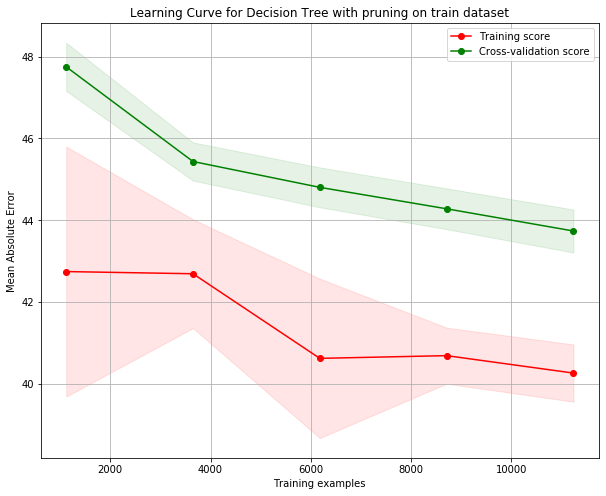

In [80]:
from sklearn.model_selection import ShuffleSplit,learning_curve,GridSearchCV,RandomizedSearchCV
title = r"Learning Curve for Decision Tree with pruning on train dataset"
estimator = grid_tree
cv = ShuffleSplit(n_splits=5, test_size=0.2, random_state=80)
%matplotlib inline
plot_learning_curve(estimator,title, x_train, y_train, None, cv=cv, n_jobs=4)

In [81]:
y_pred=grid_tree.predict(x_test)

In [84]:
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))  
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))  
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 43.273302814162854
Mean Squared Error: 4199.867637382934
Root Mean Squared Error: 64.80638577627157


In [85]:
y_train.mean()

price    152.289213
dtype: float64

**Light Gradient Boosting**

In [93]:
import lightgbm as lgb
from sklearn.model_selection import GridSearchCV,RandomizedSearchCV

In [94]:
lgbm=lgb.LGBMRegressor(max_depth=8)
lgbm.fit(x_train,y_train)
print(lgbm.score(x_train,y_train))
print(lgbm.score(x_test,y_test))

0.6881207196876986
0.5712078277094645


In [97]:
print("R Square Achieved:", lgbm.score(x_train,y_train))

R Square Achieved: 0.6881207196876986


<module 'matplotlib.pyplot' from 'C:\\ProgramData\\Anaconda3\\lib\\site-packages\\matplotlib\\pyplot.py'>

<Figure size 432x288 with 0 Axes>

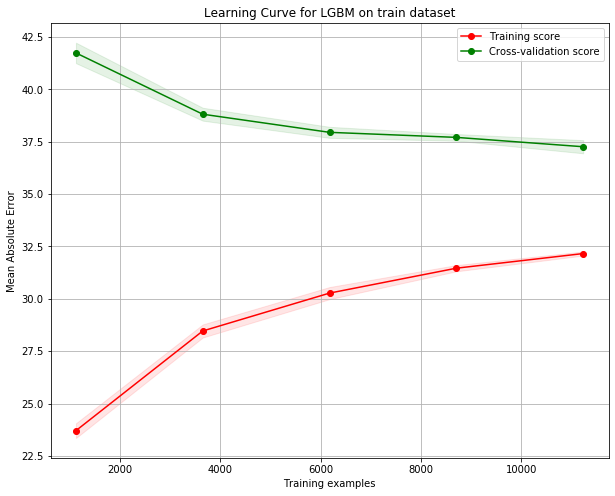

In [101]:
from sklearn.model_selection import ShuffleSplit,learning_curve,GridSearchCV,RandomizedSearchCV
title = r"Learning Curve for LGBM on train dataset"
estimator = lgbm
cv = ShuffleSplit(n_splits=5, test_size=0.2, random_state=80)
%matplotlib inline
plot_learning_curve(estimator,title, x_train, y_train, None, cv=cv, n_jobs=4)

In [98]:
lgbm.feature_importances_

array([202, 127, 116, 183, 289,  96, 222, 188, 160, 138, 375, 257,  27,
        29,   8,  13,   9,   5,  66,  82,   6,  26,  41,  11,  11,  15,
        16,  18,   5,  13,  17,  11,   3,  20,  31,  30,  41,  34,  15,
        34])

In [99]:
y_pred=lgbm.predict(x_test)

In [100]:
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))  
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))  
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 37.512903026859966
Mean Squared Error: 3021.9613133585094
Root Mean Squared Error: 54.97236863514714


# Random Forest Regressor

In [86]:
from sklearn.ensemble import RandomForestRegressor

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\weight_boosting.py:29: DeprecationWarning: numpy.core.umath_tests is an internal NumPy module and should not be imported. It will be removed in a future NumPy release.
  from numpy.core.umath_tests import inner1d


In [87]:
random_regr = RandomForestRegressor(max_depth=8,random_state=0,n_estimators=100)
random_regr.fit(x_train, y_train)
print(random_regr.score(x_train,y_train))
print(random_regr.score(x_test,y_test))

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


0.5855430084777911
0.5051786518988137


In [88]:
print("R Square Achieved:", random_regr.score(x_train,y_train))

R Square Achieved: 0.5855430084777911


<module 'matplotlib.pyplot' from 'C:\\ProgramData\\Anaconda3\\lib\\site-packages\\matplotlib\\pyplot.py'>

<Figure size 432x288 with 0 Axes>

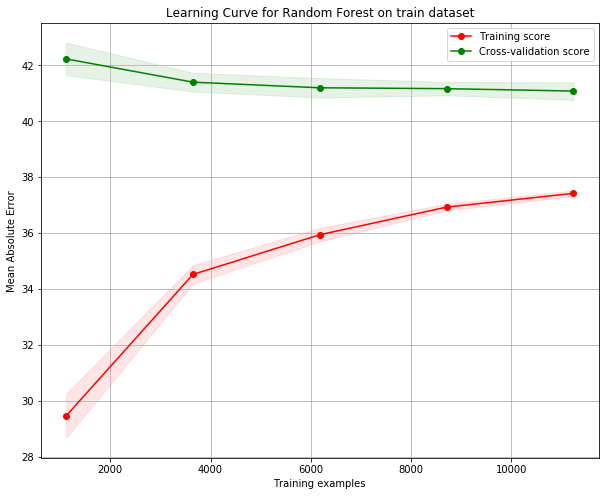

In [92]:
title = r"Learning Curve for Random Forest on train dataset"
estimator = random_regr
cv = ShuffleSplit(n_splits=5, test_size=0.2, random_state=80)
%matplotlib inline
plot_learning_curve(estimator,title, x_train, y_train, None, cv=cv, n_jobs=4)

In [89]:
y_pred=random_regr.predict(x_test)

In [90]:
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))  
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))  
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 40.38228429238471
Mean Squared Error: 3487.3093951269757
Root Mean Squared Error: 59.05344524349935


# KNearesr Neighbours Regressor

In [100]:
from sklearn.neighbors import KNeighborsRegressor
# Tune k using cross validation
knn = KNeighborsRegressor()
param_grid = {'n_neighbors' : [3,5,7,9,11,13,15,17,19]}
knn_gscv = GridSearchCV(estimator = knn, param_grid = param_grid, 
                          cv = 5, n_jobs = -1,verbose = 10,return_train_score = True,scoring='mean_absolute_error')
knn_gscv.fit(x_train, y_train)
results = knn_gscv.cv_results_

num_param = len(list(param_grid.values())[0])
train_scores = np.hstack((results['split0_train_score'].reshape((num_param,1)),results['split1_train_score'].reshape((num_param,1)),results['split2_train_score'].reshape((num_param,1))))
val_scores = np.hstack((results['split0_test_score'].reshape((num_param,1)),results['split1_test_score'].reshape((num_param,1)),results['split2_test_score'].reshape((num_param,1))))

Fitting 5 folds for each of 9 candidates, totalling 45 fits


[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:   46.5s
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done  16 tasks      | elapsed:  2.0min
[Parallel(n_jobs=-1)]: Done  25 tasks      | elapsed:  3.4min
[Parallel(n_jobs=-1)]: Done  35 out of  45 | elapsed:  4.5min remaining:  1.3min
[Parallel(n_jobs=-1)]: Done  40 out of  45 | elapsed:  4.8min remaining:   35.7s
[Parallel(n_jobs=-1)]: Done  45 out of  45 | elapsed:  5.2min remaining:    0.0s
[Parallel(n_jobs=-1)]: Done  45 out of  45 | elapsed:  5.2min finished


In [108]:
train_scores=-train_scores
val_scores=-val_scores
train_scores
val_scores

array([[45.92429097, 45.87884182, 45.21336181],
       [43.46493414, 44.06913492, 43.17301531],
       [42.62971062, 43.14382342, 42.37039109],
       [42.20695384, 43.03828962, 41.81124164],
       [41.94708567, 42.90753746, 41.2676462 ],
       [41.6065668 , 42.79368513, 41.08973903],
       [41.46125549, 42.84680195, 41.17358491],
       [41.60394111, 42.80809583, 41.11102967],
       [41.69783216, 42.71812407, 41.02495737]])

In [119]:
def plot_learning_curve(train_scores,val_scores,name,hyper_param):
    train_mean = np.mean(train_scores, axis=1)
    train_std = np.std(train_scores, axis=1)
    val_mean = np.mean(val_scores, axis=1)
    val_std = np.std(val_scores, axis=1)
    
    plt.figure(figsize=(8,5))
    plt.title(name)
    plt.xlabel(list(hyper_param.keys())[0])
    plt.ylabel("Mean Absolute Error")
    hyper_param_value = list(hyper_param.values())[0]
    plt.plot(hyper_param_value, train_mean, label="Training Score",color="red")
    plt.scatter(hyper_param_value,train_mean, color = 'red')
    plt.fill_between(hyper_param_value, train_mean - train_std,train_mean + train_std, color="red",alpha=0.25)
    plt.plot(hyper_param_value, val_mean, label="Validation Score",color="green")
    plt.scatter(hyper_param_value,val_mean, color = 'green')
    plt.xticks(np.arange(0, 22, 1.0))

    plt.fill_between(hyper_param_value, val_mean - val_std,val_mean + val_std, alpha=0.25,color="green")
    plt.legend()
    plt.grid(True)
    plt.show()

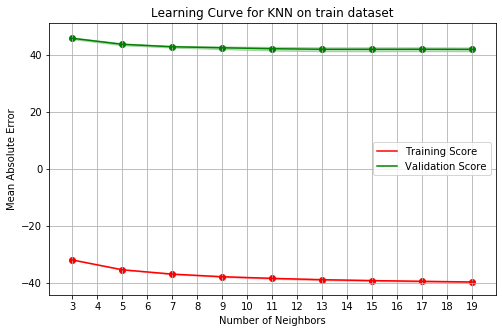

In [120]:
plot_learning_curve(train_scores,val_scores,name = "Learning Curve for KNN on train dataset",hyper_param = {'Number of Neighbors':list(param_grid.values())[0]})

In [85]:
knn_gscv.best_params_

{'n_neighbors': 15}

In [88]:
print(knn_gscv.score(x_train,y_train))
print(knn_gscv.score(x_test,y_test))

0.5303573694187355
0.4741249591308364


In [87]:
print("Optimal Value of K: ", knn_gscv.best_params_)
print("R Square Achieved:", knn_gscv.score(x_train,y_train))

Optimal Value of K:  {'n_neighbors': 15}
R Square Achieved: 0.5303573694187355


In [90]:
y_pred=knn_gscv.predict(x_test)

In [91]:
print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))  
print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))  
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

Mean Absolute Error: 41.26714285714286
Mean Squared Error: 3706.1638058324106
Root Mean Squared Error: 60.87827039126859


In [121]:
from sklearn.neighbors import KNeighborsRegressor

In [123]:
from sklearn.model_selection import cross_val_score
myList=list(range(2,20))
neighbors=filter(lambda x: x%2!=0,myList)
cv_scores=[]
for k in neighbors:
    knn=KNeighborsRegressor(n_neighbors=k)
    scores=cross_val_score(knn,x_train,y_train,cv=5,scoring='mean_absolute_error')
    cv_scores.append(scores.mean())
    print(k,cv_scores)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was rename

3 [-45.50421264981607]


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was rename

5 [-45.50421264981607, -43.58147383410466]


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was rename

7 [-45.50421264981607, -43.58147383410466, -42.69764532370442]


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was rename

9 [-45.50421264981607, -43.58147383410466, -42.69764532370442, -42.360191448123096]


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was rename

11 [-45.50421264981607, -43.58147383410466, -42.69764532370442, -42.360191448123096, -42.13443800770252]


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was rename

13 [-45.50421264981607, -43.58147383410466, -42.69764532370442, -42.360191448123096, -42.13443800770252, -41.93638579291837]


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was rename

15 [-45.50421264981607, -43.58147383410466, -42.69764532370442, -42.360191448123096, -42.13443800770252, -41.93638579291837, -41.847409517028595]


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was rename

17 [-45.50421264981607, -43.58147383410466, -42.69764532370442, -42.360191448123096, -42.13443800770252, -41.93638579291837, -41.847409517028595, -41.886478336439595]


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was renamed to neg_mean_absolute_error in version 0.18 and will be removed in 0.20.

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\metrics\scorer.py:100: DeprecationWarning:

Scoring method mean_absolute_error was rename

19 [-45.50421264981607, -43.58147383410466, -42.69764532370442, -42.360191448123096, -42.13443800770252, -41.93638579291837, -41.847409517028595, -41.886478336439595, -41.89933484476588]


Optimal value of k is:  15


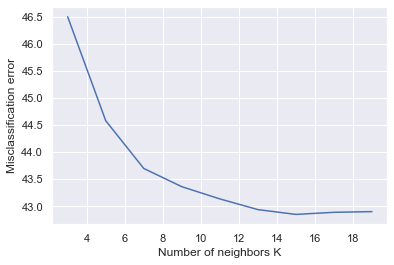

In [124]:
mse=[1- x for x in cv_scores]
nei=list(filter(lambda x: x%2!=0,myList))
k_optimal=nei[mse.index(min(mse))]
print("Optimal value of k is: ",k_optimal)
sns.set()
plt.plot(nei,mse)
plt.xlabel('Number of neighbors K')
plt.ylabel('Misclassification error')
plt.show()